In [2]:
import warnings
warnings.filterwarnings('ignore')

import skmob
from skmob.preprocessing import filtering
from skmob.preprocessing import compression
import geopandas as gpd
from skmob.utils import plot
import folium
from folium import plugins
import pandas as pd
from folium.plugins import HeatMap
import matplotlib.pyplot as plt
from stats_utils import *
from skmob.utils.plot import *
from skmob.data.load import *
import geopandas as gpd
import os

## Tessellation

### Leggiamo il geodataframe delle zone, lo puliamo e lo salviamo. 

In [2]:
directory_path = '/Users/Andre/Desktop/internship/zonizzazione_shp'
shapefile_name = '240321_Zone_zone.shp' 

shapefile_path = os.path.join(directory_path, shapefile_name)


if os.path.exists(shapefile_path):
    try:
       
        gdf = gpd.read_file(shapefile_path, encoding='UTF8')
        print("Shapefile successfully read.")
        print(gdf.head()) 
    except Exception as e:
        print(f"An error occurred while reading the shapefile: {e}")
else:
    print(f"Shapefile not found: {shapefile_path}")
    print("Please verify the shapefile name and its location.")


Shapefile successfully read.
   NO CODE                      NAME  COD_CM  COD_COMUNE  COD_PROV~1  \
0   1  ZTL             Firenze Duomo   248.0     48017.0        48.0   
1   2  ZTL          Firenze Bargello   248.0     48017.0        48.0   
2   3  ZTL    Firenze SS. Annunziata   248.0     48017.0        48.0   
3   4  ZTL  Firenze Mercato Centrale   248.0     48017.0        48.0   
4   5  ZTL  Firenze Borgo Ognissanti   248.0     48017.0        48.0   

   COD_REGI~2  NOME_CM NOME_COM~3 NOME_PRO~4 NOME_REG~5  \
0         9.0  Firenze    Firenze    Firenze    Toscana   
1         9.0  Firenze    Firenze    Firenze    Toscana   
2         9.0  Firenze    Firenze    Firenze    Toscana   
3         9.0  Firenze    Firenze    Firenze    Toscana   
4         9.0  Firenze    Firenze    Firenze    Toscana   

                                            geometry  
0  POLYGON ((681714.437 4849091.117, 681715.668 4...  
1  POLYGON ((682066.911 4848443.429, 681831.643 4...  
2  POLYGON ((68224

In [3]:
gdf

,NO,CODE,NAME,COD_CM,COD_COMUNE,COD_PROV~1,COD_REGI~2,NOME_CM,NOME_COM~3,NOME_PRO~4,NOME_REG~5,geometry
0,1,ZTL,Firenze Duomo,248.0,48017.0,48.0,9.0,Firenze,Firenze,Firenze,Toscana,"POLYGON ((681714.437 4849091.117, 681715.668 4..."
1,2,ZTL,Firenze Bargello,248.0,48017.0,48.0,9.0,Firenze,Firenze,Firenze,Toscana,"POLYGON ((682066.911 4848443.429, 681831.643 4..."
2,3,ZTL,Firenze SS. Annunziata,248.0,48017.0,48.0,9.0,Firenze,Firenze,Firenze,Toscana,"POLYGON ((682247.640 4849356.491, 682028.527 4..."
3,4,ZTL,Firenze Mercato Centrale,248.0,48017.0,48.0,9.0,Firenze,Firenze,Firenze,Toscana,"POLYGON ((681417.547 4849875.979, 681800.793 4..."
4,5,ZTL,Firenze Borgo Ognissanti,248.0,48017.0,48.0,9.0,Firenze,Firenze,Firenze,Toscana,"POLYGON ((681060.600 4849370.300, 681077.282 4..."
...,...,...,...,...,...,...,...,...,...,...,...,...
958,100005091,None,Prato_91,0.0,100005.0,100.0,9.0,-,Prato,Prato,Toscana,"POLYGON ((664498.126 4861495.862, 664483.749 4..."
959,100005094,None,Prato_94,0.0,100005.0,100.0,9.0,-,Prato,Prato,Toscana,"POLYGON ((666702.138 4863543.199, 666245.260 4..."
960,100005096,None,Prato_96,0.0,100005.0,100.0,9.0,-,Prato,Prato,Toscana,"POLYGON ((672608.495 4865655.862, 673633.487 4..."
961,100006000,None,Vaiano,0.0,100006.0,100.0,9.0,-,Vaiano,Prato,Toscana,"POLYGON ((674370.483 4871341.815, 674037.485 4..."


<Figure size 5000x5000 with 0 Axes>

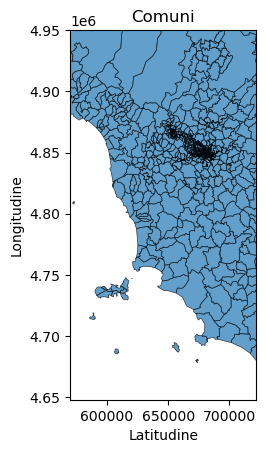

In [4]:
import geopandas as gpd
import matplotlib.pyplot as plt

plt.figure(figsize=(50, 50)) 

# Plot the GeoDataFrame
gdf.plot(edgecolor='black', linewidth=0.5, alpha=0.7)

plt.title('Comuni')
plt.xlabel('Latitudine')
plt.ylabel('Longitudine')

xmin, xmax = 570000, 722000
ymin, ymax = 4648000, 4950000

# Set the axis limits to zoom in
plt.xlim(xmin, xmax)
plt.ylim(ymin, ymax)

plt.show()


In [5]:
print(gdf.columns)


Index(['NO', 'CODE', 'NAME', 'COD_CM', 'COD_COMUNE', 'COD_PROV~1',
       'COD_REGI~2', 'NOME_CM', 'NOME_COM~3', 'NOME_PRO~4', 'NOME_REG~5',
       'geometry'],
      dtype='object')


In [6]:
gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 963 entries, 0 to 962
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   NO          963 non-null    int64   
 1   CODE        20 non-null     object  
 2   NAME        963 non-null    object  
 3   COD_CM      963 non-null    float64 
 4   COD_COMUNE  963 non-null    float64 
 5   COD_PROV~1  963 non-null    float64 
 6   COD_REGI~2  963 non-null    float64 
 7   NOME_CM     923 non-null    object  
 8   NOME_COM~3  963 non-null    object  
 9   NOME_PRO~4  963 non-null    object  
 10  NOME_REG~5  963 non-null    object  
 11  geometry    963 non-null    geometry
dtypes: float64(4), geometry(1), int64(1), object(6)
memory usage: 90.4+ KB


In [7]:
gdf.drop(columns=['CODE'],inplace=True)

In [8]:
gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 963 entries, 0 to 962
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   NO          963 non-null    int64   
 1   NAME        963 non-null    object  
 2   COD_CM      963 non-null    float64 
 3   COD_COMUNE  963 non-null    float64 
 4   COD_PROV~1  963 non-null    float64 
 5   COD_REGI~2  963 non-null    float64 
 6   NOME_CM     923 non-null    object  
 7   NOME_COM~3  963 non-null    object  
 8   NOME_PRO~4  963 non-null    object  
 9   NOME_REG~5  963 non-null    object  
 10  geometry    963 non-null    geometry
dtypes: float64(4), geometry(1), int64(1), object(5)
memory usage: 82.9+ KB


In [9]:
gdf.head(1)

,NO,NAME,COD_CM,COD_COMUNE,COD_PROV~1,COD_REGI~2,NOME_CM,NOME_COM~3,NOME_PRO~4,NOME_REG~5,geometry
0,1,Firenze Duomo,248.0,48017.0,48.0,9.0,Firenze,Firenze,Firenze,Toscana,"POLYGON ((681714.437 4849091.117, 681715.668 4..."


In [10]:
for index,row in gdf.iterrows():
        print(index,row['NOME_CM'],row['NOME_COM~3'])

0 Firenze Firenze
1 Firenze Firenze
2 Firenze Firenze
3 Firenze Firenze
4 Firenze Firenze
5 Firenze Firenze
6 Firenze Firenze
7 Firenze Firenze
8 Firenze Firenze
9 Firenze Firenze
10 Firenze Firenze
11 Firenze Firenze
12 Firenze Firenze
13 Firenze Firenze
14 Firenze Firenze
15 Firenze Firenze
16 Firenze Firenze
17 Firenze Firenze
18 Firenze Firenze
19 Firenze Firenze
20 Firenze Firenze
21 Firenze Firenze
22 Firenze Firenze
23 Firenze Firenze
24 Firenze Firenze
25 Firenze Firenze
26 Firenze Firenze
27 Firenze Firenze
28 Firenze Firenze
29 Firenze Firenze
30 Firenze Firenze
31 Firenze Firenze
32 Firenze Firenze
33 Firenze Firenze
34 Firenze Firenze
35 Firenze Firenze
36 Firenze Firenze
37 Firenze Firenze
38 Firenze Firenze
39 Firenze Firenze
40 Firenze Firenze
41 Firenze Firenze
42 Firenze Firenze
43 Firenze Firenze
44 Firenze Firenze
45 Firenze Firenze
46 Firenze Firenze
47 Firenze Firenze
48 Firenze Firenze
49 Firenze Firenze
50 Firenze Firenze
51 Firenze Firenze
52 Firenze Firenze
53 

In [11]:
gdf.drop(columns='NOME_CM', inplace=True)

In [19]:
print(sorted(gdf['NOME_COM~3'].unique()))

['Abbadia San Salvatore', 'Abetone Cutigliano', 'Agliana', 'Altopascio', 'Anghiari', "Anzola dell'Emilia", 'Arcidosso', 'Arezzo', 'Asciano', 'Aulla', 'Badia Tedalda', 'Bagni di Lucca', 'Bagno a Ripoli', 'Bagnone', "Barberino Val d'Elsa", 'Barberino di Mugello', 'Barga', 'Bentivoglio', 'Berceto', 'Bibbiena', 'Bibbona', 'Bientina', 'Bologna', 'Borgo Pace', 'Borgo San Lorenzo', 'Borgo a Mozzano', 'Brisighella', 'Bucine', 'Buggiano', 'Buonconvento', 'Buti', 'Calci', 'Calcinaia', 'Calderara di Reno', 'Calenzano', 'Camaiore', 'Campagnatico', 'Campi Bisenzio', 'Campiglia Marittima', "Campo nell'Elba", 'Camporgiano', 'Camugnano', 'Cantagallo', 'Capalbio', 'Capannoli', 'Capannori', 'Capoliveri', 'Capolona', 'Capraia Isola', 'Capraia e Limite', 'Caprese Michelangelo', 'Careggine', 'Carmignano', 'Carrara', 'Casale Marittimo', 'Casalecchio di Reno', 'Casciana Terme Lari', 'Cascina', 'Casola in Lunigiana', "Casole d'Elsa", 'Castagneto Carducci', 'Castel Bolognese', 'Castel Focognano', 'Castel Maggi

In [12]:
#Togliamo i comuni non identificati
gdf = gdf[gdf['NOME_COM~3'] != '-'].reset_index(drop=True)

In [13]:
gdf.rename(columns={"NOME_COM~3": "Nome_Comune","COD_PROV~1": "Cod_Provincia","COD_REGI~2":"Cod_Regione","NOME_PRO~4":"Nome_Provincia","NOME_REG~5":"Nome_Regione"}, inplace=True)

In [14]:
gdf['COD_CM'].unique()

array([248.,   0.])

In [15]:
gdf.drop(columns='COD_CM',inplace=True)

In [16]:
gdf.head()

,NO,NAME,COD_COMUNE,Cod_Provincia,Cod_Regione,Nome_Comune,Nome_Provincia,Nome_Regione,geometry
0,1,Firenze Duomo,48017.0,48.0,9.0,Firenze,Firenze,Toscana,"POLYGON ((681714.437 4849091.117, 681715.668 4..."
1,2,Firenze Bargello,48017.0,48.0,9.0,Firenze,Firenze,Toscana,"POLYGON ((682066.911 4848443.429, 681831.643 4..."
2,3,Firenze SS. Annunziata,48017.0,48.0,9.0,Firenze,Firenze,Toscana,"POLYGON ((682247.640 4849356.491, 682028.527 4..."
3,4,Firenze Mercato Centrale,48017.0,48.0,9.0,Firenze,Firenze,Toscana,"POLYGON ((681417.547 4849875.979, 681800.793 4..."
4,5,Firenze Borgo Ognissanti,48017.0,48.0,9.0,Firenze,Firenze,Toscana,"POLYGON ((681060.600 4849370.300, 681077.282 4..."


In [47]:
gdf.to_file('ZonePulite.geojson', driver='GeoJSON')

AttributeError: module 'pandas' has no attribute 'Int64Index'

In [17]:
zone_comuni={}
for index, row in gdf.iterrows():
    if row['Nome_Comune'] not in zone_comuni:
        zone_comuni[row['Nome_Comune']]=[row['NO']]
    else:
        zone_comuni[row['Nome_Comune']].append(row['NO'])


In [18]:
zone_comuni


{'Firenze': [1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50,
  51,
  52,
  53,
  54,
  55,
  56,
  57,
  58,
  59,
  60,
  61,
  62,
  63,
  64,
  65,
  66,
  67,
  68,
  69,
  70,
  71,
  72,
  73,
  74,
  75,
  76,
  77,
  78,
  79,
  80,
  81,
  82,
  83,
  84,
  85,
  86,
  87,
  88,
  89,
  90,
  91,
  92,
  93,
  94,
  95,
  96,
  97,
  98,
  99,
  100,
  101,
  102,
  103,
  104,
  105,
  106,
  107,
  108,
  109,
  110,
  111,
  112,
  113,
  114,
  115,
  117,
  118,
  119,
  120,
  121,
  122,
  123,
  124,
  125,
  126,
  127,
  128,
  129,
  130,
  132,
  133,
  134,
  135,
  136,
  137,
  138,
  139,
  140,
  141,
  142,
  143,
  144,
  145,
  146,
  147,
  148,
  149,
  150,
  151,
  152,
  153,
  154,
  155,
  156,
  158,
  159,
  160,
  16

In [19]:
gdf['Nome_Comune'].unique()

array(['Firenze', 'Scandicci', 'Campi Bisenzio', 'Sesto Fiorentino',
       'Fiesole', 'Bagno a Ripoli', 'Impruneta', 'Lastra a Signa',
       'Signa', 'Calenzano', 'Vaglia', 'Montelupo Fiorentino',
       'Firenzuola', 'Palazzuolo sul Senio', 'Marradi',
       'Barberino di Mugello', 'Scarperia', 'Borgo San Lorenzo',
       'San Piero a Sieve', 'Vicchio', 'Dicomano', 'San Godenzo', 'Londa',
       'Rufina', 'Pontassieve', 'Pelago', "Rignano sull'Arno", 'Reggello',
       'Incisa Valdarno', 'Figline Valdarno', 'Greve in Chianti',
       'San Casciano in Val di Pesa', 'Tavernelle',
       "Barberino Val d'Elsa", 'Fucecchio', 'Cerreto Guidi', 'Vinci',
       'Capraia e Limite', 'Empoli', 'Montaione', 'Gambassi Terme',
       'Castelfiorentino', 'Montespertoli', 'Certaldo', 'Luni', 'Berceto',
       'Ventasso', "Anzola dell'Emilia", 'Bentivoglio', 'Bologna',
       'Calderara di Reno', 'Camugnano', 'Casalecchio di Reno',
       'Castel del Rio', 'Castel Maggiore', 'Castenaso',
       'Cas

In [3]:
gdf=gpd.read_file('ZonePulite.geojson', driver='GeoJSON')

In [20]:
lista_zone=(gdf['NO'].unique()).tolist()

In [21]:
lista_zone

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,
 185,
 186,
 187,
 188,
 18

In [22]:
check=gdf[gdf['NO']==1010000]
check

,NO,NAME,COD_COMUNE,Cod_Provincia,Cod_Regione,Nome_Comune,Nome_Provincia,Nome_Regione,geometry


In [23]:

cod_comune_check = gdf.groupby('Nome_Comune')['COD_COMUNE'].nunique()


inconsistent_comuni = cod_comune_check[cod_comune_check > 1]


if not inconsistent_comuni.empty:
    print("Inconsistencies found:")
    display(inconsistent_comuni)
else:
    print("All comuni have consistent COD_COMUNE values.")


All comuni have consistent COD_COMUNE values.


In [41]:
gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 866 entries, 0 to 865
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   NO              866 non-null    int64   
 1   NAME            866 non-null    object  
 2   COD_COMUNE      866 non-null    float64 
 3   Cod_Provincia   866 non-null    float64 
 4   Cod_Regione     866 non-null    float64 
 5   Nome_Comune     866 non-null    object  
 6   Nome_Provincia  866 non-null    object  
 7   Nome_Regione    866 non-null    object  
 8   geometry        866 non-null    geometry
dtypes: float64(3), geometry(1), int64(1), object(4)
memory usage: 61.0+ KB


### Mergiamo le zone in comuni di appartenenza

In [24]:
aggregated_gdf = gdf.dissolve(by='COD_COMUNE')


aggregated_gdf.head(5)

,geometry,NO,NAME,Cod_Provincia,Cod_Regione,Nome_Comune,Nome_Provincia,Nome_Regione
COD_COMUNE,,,,,,,,
11020.0,"POLYGON ((582703.141 4879659.469, 581618.329 4...",11020000,A12 - Liguria,11.0,7.0,Luni,La Spezia,Liguria
34004.0,"POLYGON ((573515.003 4924755.433, 572321.122 4...",34004000,A15 - Emilia Romagna,34.0,8.0,Berceto,Parma,Emilia-Romagna
35046.0,"POLYGON ((593115.003 4909179.549, 592619.258 4...",35046000,SS63,35.0,8.0,Ventasso,Reggio nell'Emilia,Emilia-Romagna
37001.0,"POLYGON ((673057.771 4933672.770, 673326.958 4...",37001000,Anzola dell'Emilia,37.0,8.0,Anzola dell'Emilia,Bologna,Emilia-Romagna
37005.0,"POLYGON ((690516.891 4939753.776, 690403.517 4...",37005000,A13 - Bologna,37.0,8.0,Bentivoglio,Bologna,Emilia-Romagna


### Plottiamo in Folium e salviamo tessellazione comuni toscani

In [42]:
aggregated_gdf.columns

Index(['geometry', 'NO', 'NAME', 'Cod_Provincia', 'Cod_Regione', 'Nome_Comune',
       'Nome_Provincia', 'Nome_Regione'],
      dtype='object')

In [43]:
invalid_geometries = aggregated_gdf[~aggregated_gdf.is_valid]
print(invalid_geometries)


Empty GeoDataFrame
Columns: [geometry, NO, NAME, Cod_Provincia, Cod_Regione, Nome_Comune, Nome_Provincia, Nome_Regione]
Index: []


In [27]:
print(aggregated_gdf.head(3))

                                                     geometry        NO  \
COD_COMUNE                                                                
11020.0     POLYGON ((582703.141 4879659.469, 581618.329 4...  11020000   
34004.0     POLYGON ((573515.003 4924755.433, 572321.122 4...  34004000   
35046.0     POLYGON ((593115.003 4909179.549, 592619.258 4...  35046000   

                            NAME  Cod_Provincia  Cod_Regione Nome_Comune  \
COD_COMUNE                                                                 
11020.0            A12 - Liguria           11.0          7.0        Luni   
34004.0     A15 - Emilia Romagna           34.0          8.0     Berceto   
35046.0                     SS63           35.0          8.0    Ventasso   

                Nome_Provincia    Nome_Regione  
COD_COMUNE                                      
11020.0              La Spezia         Liguria  
34004.0                  Parma  Emilia-Romagna  
35046.0     Reggio nell'Emilia  Emilia-Romagna 

In [28]:
print(aggregated_gdf.crs)


epsg:32632


Questo è importante: GeoDataFrame (aggregated_gdf) is currently using the EPSG:32632 coordinate reference system (CRS)! we need to reproject it to EPSG:4326, which is compatible with Folium for mapping. EPSG:32632 is a UTM (Universal Transverse Mercator) projection, while EPSG:4326 uses latitude and longitude (WGS84).

In [29]:
aggregated_gdf = aggregated_gdf.to_crs(epsg=4326)


In [30]:
print(aggregated_gdf.crs)

EPSG:4326


In [31]:
aggregated_gdf['Nome_Regione'].unique()

array(['Liguria', 'Emilia-Romagna', 'Marche', 'Toscana', 'Umbria',
       'Lazio'], dtype=object)

In [48]:
aggregated_gdf=aggregated_gdf[aggregated_gdf['Nome_Regione'] == 'Toscana'] 

In [49]:
aggregated_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Float64Index: 276 entries, 45001.0 to 100007.0
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   geometry        276 non-null    geometry
 1   NO              276 non-null    int64   
 2   NAME            276 non-null    object  
 3   Cod_Provincia   276 non-null    float64 
 4   Cod_Regione     276 non-null    float64 
 5   Nome_Comune     276 non-null    object  
 6   Nome_Provincia  276 non-null    object  
 7   Nome_Regione    276 non-null    object  
dtypes: float64(2), geometry(1), int64(1), object(4)
memory usage: 19.4+ KB


In [78]:
aggregated_gdf.to_file("/Users/Andre/Desktop/Internship/TessellationToscana.geojson", driver="GeoJSON")

In [7]:
aggregated_gdf=gpd.read_file("/Users/Andre/Desktop/Internship/TessellationToscana.geojson", driver="GeoJSON")

In [50]:
def style_function(feature):
    if feature['properties']['Nome_Regione'] == 'Toscana':
        return {
            'fillColor': 'green',
            'color': 'green',
            'weight': 0.5,
            'fillOpacity': 0.1,
        }
    else:
        return {
            'fillColor': 'blue',
            'color': 'blue',
            'weight': 1,
            'fillOpacity': 0.1,
        }


In [51]:
import folium

latitude = 43.7696
longitude = 11.2558
map_f = folium.Map(location=[latitude, longitude], zoom_start=8, tiles='CartoDB positron')


folium.GeoJson(
    aggregated_gdf,
    style_function=style_function,
    tooltip=folium.GeoJsonTooltip(
        fields=['NAME', 'Nome_Provincia'],
        aliases=['Name:', 'Nome_Provincia:'],
        localize=True
    )
).add_to(map_f)


map_f


<Axes: >

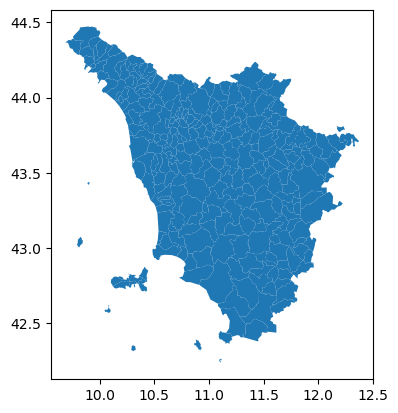

In [52]:
aggregated_gdf.plot()

In [39]:
filtered_rows = aggregated_gdf[aggregated_gdf['NO'] ==1]


filtered_rows


,geometry,NO,NAME,Cod_Provincia,Cod_Regione,Nome_Comune,Nome_Provincia,Nome_Regione
COD_COMUNE,,,,,,,,
48017.0,"POLYGON ((11.20331 43.75236, 11.20265 43.75289...",1,Firenze Duomo,48.0,9.0,Firenze,Firenze,Toscana


<Axes: >

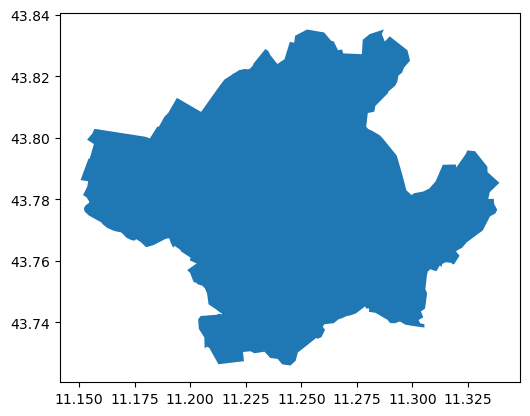

In [40]:
filtered_rows.plot()

In [83]:
aggregated_gdf.columns

Index(['COD_COMUNE', 'NO', 'NAME', 'Cod_Provincia', 'Cod_Regione',
       'Nome_Comune', 'Nome_Provincia', 'Nome_Regione', 'geometry'],
      dtype='object')

In [85]:
aggregated_gdf.columns

Index(['COD_COMUNE', 'NO', 'NAME', 'Cod_Provincia', 'Cod_Regione',
       'Nome_Comune', 'Nome_Provincia', 'Nome_Regione', 'geometry'],
      dtype='object')

## Indicatori Economici

In [9]:
indicatori=pd.read_csv('Internship/indicatori/Indicatori_2022.csv',encoding='ISO-8859-1',sep=';')

In [10]:
indicatori.columns

Index(['comune', 'cod_istat_comune', 'ind01', 'ind02', 'ind03', 'ind04',
       'ind05', 'ind06', 'ind07', 'ind08', 'ind09', 'ind10', 'ind11', 'ind12',
       'ind13', 'ind14', 'ind15', 'ind16', 'ind17', 'ind18', 'ind19', 'ind20'],
      dtype='object')

In [11]:
indicatori.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 274 entries, 0 to 273
Data columns (total 22 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   comune            274 non-null    object 
 1   cod_istat_comune  273 non-null    float64
 2   ind01             274 non-null    object 
 3   ind02             274 non-null    object 
 4   ind03             274 non-null    object 
 5   ind04             274 non-null    object 
 6   ind05             274 non-null    object 
 7   ind06             274 non-null    object 
 8   ind07             274 non-null    object 
 9   ind08             274 non-null    int64  
 10  ind09             274 non-null    object 
 11  ind10             274 non-null    object 
 12  ind11             274 non-null    object 
 13  ind12             274 non-null    object 
 14  ind13             274 non-null    object 
 15  ind14             274 non-null    object 
 16  ind15             274 non-null    object 
 1

In [12]:

column_mapping = {    'ind01': 'Percentage Change in Resident Population (3 years)',
    'ind02': 'Percentage of Population Over 80 Years Old',
    'ind03': 'Natural Balance (Relative)',
    'ind04': 'Percentage of Young Foreigners (0-19 Years)',
    'ind05': 'Percentage of Youth (15-24) in Other Professional Conditions',
    'ind06': 'Percentage of Individuals (25-49) with Tertiary Education',
    'ind07': 'Percentage of Taxpayers with Income Below €10,000',
    'ind08': 'Average Taxable Income (Euros) Per Taxpayer',
    'ind09': 'Percentage of Job Seekers in the Labor Force',
    'ind10': 'Percentage of Active Sole Proprietorships with Foreign-Born Owner',
    'ind11': 'Environmental Risk Index',
    'ind12': 'Percentage of Land Consumed',
    'ind13': 'Tourism Pressure (per 1,000 Inhabitants)',
    'ind14': 'Organizations Registered in Regional Registers Per 10,000 Residents',
    'ind15': 'Individuals (0-64) with Disabilities Per 1,000 Residents',
    'ind16': 'Local Units Providing Health Assistance Per 1,000 Residents',
    'ind17': 'Percentage of Services Offered Online at the Highest Level by Municipalities',
    'ind18': 'Emergency Response Time Target Indicator (75th Percentile)',
    'ind19': 'Percentage of Active Enterprises in Innovation Sectors',
    'ind20': 'Percentage of Agricultural Area Cultivated Using Organic Methods'
}

indicatori.rename(columns=column_mapping, inplace=True)


In [13]:
indicatori = indicatori[indicatori['comune'] != 'Toscana']

In [14]:
indicatori.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 273 entries, 0 to 272
Data columns (total 22 columns):
 #   Column                                                                        Non-Null Count  Dtype  
---  ------                                                                        --------------  -----  
 0   comune                                                                        273 non-null    object 
 1   cod_istat_comune                                                              273 non-null    float64
 2   Percentage Change in Resident Population (3 years)                            273 non-null    object 
 3   Percentage of Population Over 80 Years Old                                    273 non-null    object 
 4   Natural Balance (Relative)                                                    273 non-null    object 
 5   Percentage of Young Foreigners (0-19 Years)                                   273 non-null    object 
 6   Percentage of Youth (15-24) in Oth

In [15]:
indicatori.loc[37]

comune                                                                          Barberino Tavarnelle
cod_istat_comune                                                                             48054.0
Percentage Change in Resident Population (3 years)                                              -0,4
Percentage of Population Over 80 Years Old                                                      10,9
Natural Balance (Relative)                                                                     -0,33
Percentage of Young Foreigners (0-19 Years)                                                     18,6
Percentage of Youth (15-24) in Other Professional Conditions                                     3,2
Percentage of Individuals (25-49) with Tertiary Education                                       17,8
Percentage of Taxpayers with Income Below €10,000                                               20,7
Average Taxable Income (Euros) Per Taxpayer                                                

In [543]:
indicatori.loc[234]

comune                                                                          Barberino Tavarnelle
cod_istat_comune                                                                             48003.0
Percentage Change in Resident Population (3 years)                                              -0,4
Percentage of Population Over 80 Years Old                                                      10,9
Natural Balance (Relative)                                                                     -0,33
Percentage of Young Foreigners (0-19 Years)                                                     18,6
Percentage of Youth (15-24) in Other Professional Conditions                                     3,2
Percentage of Individuals (25-49) with Tertiary Education                                       17,8
Percentage of Taxpayers with Income Below €10,000                                               20,7
Average Taxable Income (Euros) Per Taxpayer                                                

In [16]:
rows_to_duplicate = indicatori.loc[[37, 49, 71]]

indicatori = pd.concat([indicatori, rows_to_duplicate], ignore_index=True)

In [17]:
#siccome non c'è corrispondenza tra tessellation e indicatori perché 6 comuni sono stati fusi in 3, li ricreiamo prima del merge
indicatori.loc[49, 'cod_istat_comune'] = 48016.0
indicatori.loc[274, 'cod_istat_comune'] = 48023.0
indicatori.loc[37, 'cod_istat_comune'] = 48003.0
indicatori.loc[273, 'cod_istat_comune'] = 48045.0
indicatori.loc[71, 'cod_istat_comune'] = 48042.0
indicatori.loc[275, 'cod_istat_comune'] = 48040.0

In [18]:
tessellation=gpd.read_file("/Users/Andre/Desktop/Internship/TessellationToscana.geojson", driver="GeoJSON")

In [19]:
indicatori_df = pd.merge(indicatori, tessellation, left_on='cod_istat_comune', right_on='COD_COMUNE', how='left')

In [20]:
indicatori_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 276 entries, 0 to 275
Data columns (total 31 columns):
 #   Column                                                                        Non-Null Count  Dtype   
---  ------                                                                        --------------  -----   
 0   comune                                                                        276 non-null    object  
 1   cod_istat_comune                                                              276 non-null    float64 
 2   Percentage Change in Resident Population (3 years)                            276 non-null    object  
 3   Percentage of Population Over 80 Years Old                                    276 non-null    object  
 4   Natural Balance (Relative)                                                    276 non-null    object  
 5   Percentage of Young Foreigners (0-19 Years)                                   276 non-null    object  
 6   Percentage of Youth (15-24

In [559]:
indicatori_df.tail(5)

,comune,cod_istat_comune,Percentage Change in Resident Population (3 years),Percentage of Population Over 80 Years Old,Natural Balance (Relative),Percentage of Young Foreigners (0-19 Years),Percentage of Youth (15-24) in Other Professional Conditions,Percentage of Individuals (25-49) with Tertiary Education,"Percentage of Taxpayers with Income Below €10,000",Average Taxable Income (Euros) Per Taxpayer,...,Percentage of Agricultural Area Cultivated Using Organic Methods,COD_COMUNE,NO,NAME,Cod_Provincia,Cod_Regione,Nome_Comune,Nome_Provincia,Nome_Regione,geometry
271,Torrita di Siena,52035.0,"-1,5","12,5","-0,51","18,6","4,8","15,7","22,6",20424,...,"34,3",52035.0,52035000,Torrita di Siena,52.0,9.0,Torrita di Siena,Siena,Toscana,"POLYGON ((11.79122 43.19813, 11.81253 43.19136..."
272,Trequanda,52036.0,-3,"15,3","-0,86",14,"5,2","19,1","27,6",20900,...,34,52036.0,52036000,Trequanda,52.0,9.0,Trequanda,Siena,Toscana,"POLYGON ((11.67324 43.17031, 11.64885 43.17487..."
273,Barberino Tavarnelle,48045.0,"-0,4","10,9","-0,33","18,6","3,2","17,8","20,7",23591,...,"18,8",48045.0,849,Tavarnelle,48.0,9.0,Tavernelle,Firenze,Toscana,"POLYGON ((11.25212 43.59129, 11.25919 43.59426..."
274,Figline e Incisa Valdarno,48023.0,"-0,8","11,4","-0,41",21,"4,5","16,6","20,2",22333,...,"32,8",48023.0,839,Incisa Valdarno,48.0,9.0,Incisa Valdarno,Firenze,Toscana,"POLYGON ((11.39184 43.66168, 11.39242 43.67044..."
275,Scarperia e San Piero,48040.0,"-0,4","10,5","-0,25","20,9","3,7","14,3","18,6",22713,...,"36,2",48040.0,817,San Piero a Sieve,48.0,9.0,San Piero a Sieve,Firenze,Toscana,"POLYGON ((11.25858 43.93457, 11.25030 43.93051..."


In [551]:
specific_rows = tessellation.loc[tessellation['Nome_Comune'].str.startswith('Barbe')]
print(specific_rows)

    COD_COMUNE   NO                  NAME  Cod_Provincia  Cod_Regione  \
71     48002.0  807         BAR Cavallina           48.0          9.0   
72     48003.0  851  Barberino Val d'elsa           48.0          9.0   

             Nome_Comune Nome_Provincia Nome_Regione  \
71  Barberino di Mugello        Firenze      Toscana   
72  Barberino Val d'Elsa        Firenze      Toscana   

                                             geometry  
71  POLYGON ((11.26053 43.97075, 11.25686 43.96781...  
72  POLYGON ((11.08526 43.51622, 11.11335 43.52352...  


In [522]:
nan_rows = indicatori_df[indicatori_df.isna().any(axis=1)]
print(nan_rows)


Empty DataFrame
Columns: [comune, cod_istat_comune, Percentage Change in Resident Population (3 years), Percentage of Population Over 80 Years Old, Natural Balance (Relative), Percentage of Young Foreigners (0-19 Years), Percentage of Youth (15-24) in Other Professional Conditions, Percentage of Individuals (25-49) with Tertiary Education, Percentage of Taxpayers with Income Below €10,000, Average Taxable Income (Euros) Per Taxpayer, Percentage of Job Seekers in the Labor Force, Percentage of Active Sole Proprietorships with Foreign-Born Owner, Environmental Risk Index, Percentage of Land Consumed, Tourism Pressure (per 1,000 Inhabitants), Organizations Registered in Regional Registers Per 10,000 Residents, Individuals (0-64) with Disabilities Per 1,000 Residents, Local Units Providing Health Assistance Per 1,000 Residents, Percentage of Services Offered Online at the Highest Level by Municipalities, Emergency Response Time Target Indicator (75th Percentile), Percentage of Active Enter

In [22]:
indicatori_gdf=gpd.GeoDataFrame(
    indicatori_df,  
    geometry=indicatori_df["geometry"])

In [23]:
indicatori_gdf.columns = (
    indicatori_gdf.columns
    .str.strip()  # Toglie spazi prima e dopo 
    .str.replace(r"[^a-zA-Z0-9_]", "_", regex=True)  # Rimpiazza con underscore i valori speciali
)

In [25]:
for col in indicatori_gdf.select_dtypes(include='object').columns:
    indicatori_gdf[col] = (
        indicatori_gdf[col]
        .str.replace(",", ".", regex=False)  #Se indicatori hanno virgole nei decimali si cambiano in punti
        .astype(float, errors="ignore")  # Cambia in float se possibile
    )


In [26]:
indicatori_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 276 entries, 0 to 275
Data columns (total 31 columns):
 #   Column                                                                        Non-Null Count  Dtype   
---  ------                                                                        --------------  -----   
 0   comune                                                                        276 non-null    object  
 1   cod_istat_comune                                                              276 non-null    float64 
 2   Percentage_Change_in_Resident_Population__3_years_                            276 non-null    float64 
 3   Percentage_of_Population_Over_80_Years_Old                                    276 non-null    float64 
 4   Natural_Balance__Relative_                                                    276 non-null    float64 
 5   Percentage_of_Young_Foreigners__0_19_Years_                                   276 non-null    float64 
 6   Percentage_of_Yout

In [767]:

indicators=list(indicatori_gdf.columns)

options = sorted(ind for ind in indicators if ind not in['comune','cod_istat_comune','COD_COMUNE', 'NO', 'NAME', 'Cod_Provincia', 'Cod_Regione',
       'Nome_Comune', 'Nome_Provincia', 'Nome_Regione', 'geometry'])
selected_indicator = alt.param(
    name='indicator',
    bind=alt.binding_select(options=options, name="Select Indicator"),
    value=options[0]  
)


indicatori_gdf = indicatori_gdf.set_crs(epsg=4326).to_crs(epsg=4326)


geojson = indicatori_gdf.__geo_interface__


base = alt.Chart(alt.Data(values=geojson["features"])).mark_geoshape().encode(
    color=alt.Color(
        "selected_value:Q",
        title='Selected Indicator'
    ),
    tooltip=[
        alt.Tooltip("properties.comune:N", title="Comune"),
        alt.Tooltip("selected_value:Q", title="Selected Indicator")
    ]
).add_params(
    selected_indicator  
).transform_calculate(
    selected_value='datum.properties[indicator]'  
).project(
    type="mercator"
).properties(
    width=500,
    height=400
)


base.show()

alt.Chart(...)

In [28]:
main= gpd.read_file("Internship/zip infrastrutture/superstrade.shp")

<Axes: >

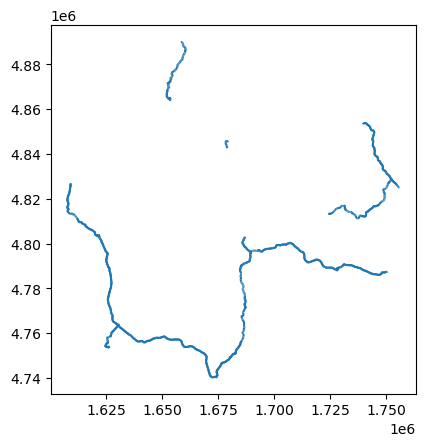

In [29]:
main.plot()

In [31]:
autostrade= gpd.read_file("Internship/zip infrastrutture/strade_importarti.shp")

<Axes: >

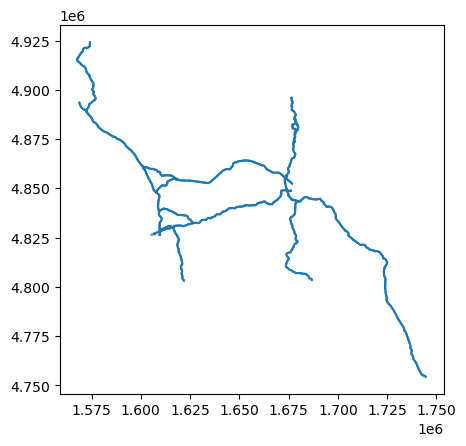

In [32]:
autostrade.plot()

In [34]:
import altair as alt
autostrade = autostrade.to_crs(epsg=4326)


geojson_strade = autostrade.__geo_interface__

autostrade=alt.Chart(alt.Data(values=geojson_strade["features"])).mark_geoshape(stroke="grey",
    strokeWidth=2, fill=None).encode(
    
).project(
    type="mercator"
).properties(
    width=800,  
    height=600,  
    title="Main Roads"
)


autostrade

alt.Chart(...)

In [35]:
stazioni_gdf = gpd.read_file("internship/ferrovie/Stazioni.shp")

In [36]:
stazioni_gdf = stazioni_gdf.to_crs(epsg=4326)

In [37]:
stazioni_gdf

,pk_uid,cod_stz,den_uff,cod_gnz,x_stz,y_stz,tip_gnz,gnz,org,origine,indirizzo,comune,provincia,gestore,categoria,cod_sta,data_agg,data_elab,geometry
0,1,RTT0900895SF,FORNACI DI BARGA,RTT0900895GK,1.618138e+06,4.877934e+06,0400,"variazione di sede/sottopasso (SOT_PAS, COD_SED)",0201,estrazione da ctr10k,Piazza Stazione n.1,Barga,LU,RFI,bronze,0100,20190904,20191024,POINT (10.47426 44.04491)
1,2,RTT0900742SF,FORTE DEI MARMI-SERAVEZZA-QUERCETA,RTT0900742GK,1.596228e+06,4.870118e+06,0400,"variazione di sede/sottopasso (SOT_PAS, COD_SED)",0201,estrazione da ctr10k,Via Aurelia n.351,Seravezza,LU,RFI,silver,0100,20190904,20191024,POINT (10.19942 43.97776)
2,4,RTT0900334SF,GAVORRANO,RTT0900334GK,1.657763e+06,4.756874e+06,0400,"variazione di sede/sottopasso (SOT_PAS, COD_SED)",0201,estrazione da ctr10k,Via Aurelia 25- Loc. Potassa,Gavorrano,GR,RFI,bronze,0100,20190904,20191024,POINT (10.93352 42.94805)
3,5,RTT0900882SF,GHIVIZZANO-COREGLIA,RTT0900882GK,1.621054e+06,4.876063e+06,0400,"variazione di sede/sottopasso (SOT_PAS, COD_SED)",0201,estrazione da ctr10k,Via Stazione,Coreglia Antelminelli,LU,RFI,bronze,0100,20190904,20191024,POINT (10.51022 44.02760)
4,8,RTT0900085SF,GRANAIOLO,RTT0900085GK,1.656894e+06,4.835104e+06,0400,"variazione di sede/sottopasso (SOT_PAS, COD_SED)",0205,estrazione da ctr25k,Piazza Stazione,Empoli,FI,RFI,bronze,0100,20190904,20191024,POINT (10.94520 43.65224)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
176,252,RTT0903204SF,ASCIANO-MONTE OLIVETO MAGGIORE,RTT0903204GK,1.708212e+06,4.789768e+06,0400,"variazione di sede/sottopasso (SOT_PAS, COD_SED)",0201,estrazione da ctr10k,Via Laurentana,Asciano,SI,RFI,silver,0100,20190904,20191024,POINT (11.56371 43.23185)
177,253,RTT0900064SF,AULLA LUNIGIANA,RTT0900064GK,1.577569e+06,4.895609e+06,0400,"variazione di sede/sottopasso (SOT_PAS, COD_SED)",0201,estrazione da ctr10k,Piazza A.Straulino,Aulla,MS,RFI,silver,0100,20190904,20191024,POINT (9.97057 44.20942)
178,255,RTT0903660SF,BADESSE,RTT0903715GK,1.684146e+06,4.806165e+06,0400,"variazione di sede/sottopasso (SOT_PAS, COD_SED)",0700,da integrazione grafi,Via Giuseppe Verdi,Monteriggioni,SI,RFI,bronze,0100,20190904,20191024,POINT (11.27309 43.38564)
179,257,RTT0900875SF,BAGNI DI LUCCA,RTT0900875GK,1.624427e+06,4.873439e+06,0400,"variazione di sede/sottopasso (SOT_PAS, COD_SED)",0201,estrazione da ctr10k,Piazzale Europa n. 5,Bagni di Lucca,LU,RFI,bronze,0100,20190904,20191024,POINT (10.55167 44.00341)


In [39]:
stazioni_gdf['longitude'] = stazioni_gdf.geometry.x
stazioni_gdf['latitude'] = stazioni_gdf.geometry.y

In [40]:
import altair as alt


stazioni_chart = alt.Chart(stazioni_gdf).mark_circle(size=50).encode(
    longitude='longitude:Q',
    latitude='latitude:Q',
    color=alt.Color("categoria:N", title="Categoria Stazione"),
    tooltip=[
        alt.Tooltip("comune:N", title="Comune"),
        alt.Tooltip("categoria:N", title="Categoria")
    ]
).project(
    type="mercator"
).properties(
    width=800,  
    height=600,  
    title="Distribuzione delle Stazioni per Categoria"
).configure_view(
    stroke=None  
)


stazioni_chart


alt.Chart(...)

In [673]:
import altair as alt
toggle_strade = alt.param(
    name='toggle_strade',
    bind=alt.binding_radio(options=['Show Motorways', 'Hide Motorways'], name='Motorways:'),
    value='Show Motorways')
autostrade = autostrade.to_crs(epsg=4326)
geojson_strade = autostrade.__geo_interface__

strade=alt.Chart(alt.Data(values=geojson_strade["features"])).mark_geoshape(stroke="grey",
    strokeWidth=2, fill=None).encode(opacity=alt.condition(
            "toggle_Motorways == 'Show Motorways'",
            alt.value(0.8),
            alt.value(0)
        )).project(
    type="mercator"
).properties(
    width=800,  
    height=600,  
    title="Motorways"
)


strade

toggle_stazioni = alt.param(
    name='toggle_stazioni',
    bind=alt.binding_radio(options=['Show Stations', 'Hide Stations'], name='Stations:'),
    value='Show Stations')

color_mapping = {
    "silver": "grey",  
    "gold": "red",
    "platinum":"yellow"
}
stazioni_=stazioni_gdf[stazioni_gdf['categoria']!='bronze']
stazioni = alt.Chart(stazioni_).mark_circle(size=50).encode(
    longitude='longitude:Q',
    latitude='latitude:Q',
    color=alt.Color("categoria:N", title="Station Category",scale=alt.Scale(
            domain=list(color_mapping.keys()),   
            range=list(color_mapping.values())   
        )),opacity=alt.condition(
            "toggle_stazioni == 'Show Stations'",
            alt.value(0.8),
            alt.value(0)
        ),
    tooltip=[
        alt.Tooltip("comune:N", title="Comune"),
        alt.Tooltip("categoria:N", title="Category")
    ]
).project(
    type="mercator"
).properties(
    width=600,  
    height=500,  
    title=""
).add_params(
    toggle_stazioni  
)

indicators=list(indicatori_gdf.columns)

options = sorted(ind for ind in indicators if ind not in['comune','cod_istat_comune','COD_COMUNE', 'NO', 'NAME', 'Cod_Provincia', 'Cod_Regione',
       'Nome_Comune', 'Nome_Provincia', 'Nome_Regione', 'geometry'])
selected_indicator = alt.param(
    name='indicator',
    bind=alt.binding_select(options=options, name="Select Indicator"),
    value=options[0]  
)


indicatori_gdf = indicatori_gdf.set_crs(epsg=4326).to_crs(epsg=4326)


geojson = indicatori_gdf.__geo_interface__


base = alt.Chart(alt.Data(values=geojson["features"])).mark_geoshape().encode(
    color=alt.Color(
        "selected_value:Q",
        title='Selected Indicator'
    ),
    tooltip=[
        alt.Tooltip("properties.comune:N", title="Comune"),
        alt.Tooltip("selected_value:Q", title="Selected Indicator")
    ]
).add_params(
    selected_indicator  
).transform_calculate(
    selected_value='datum.properties[indicator]'  
).project(
    type="mercator"
).properties(
    width=600,
    height=500
)



base = base.encode(
    opacity=alt.value(0.7)
)
combined_chart = (base + stazioni)
combined_chart

alt.LayerChart(...)

In [42]:
motorways= gpd.read_file("Internship/zip infrastrutture/strade_importarti.shp")
roads=gpd.read_file("Internship/zip infrastrutture/superstrade.shp")

In [817]:
import altair as alt
toggle_autostrade = alt.param(
    name='toggle_autostrade',
    bind=alt.binding_radio(options=['Show Motorways', 'Hide Motorways'], name='Motorways:'),
    value='Show Motorways')
motorways = motorways.to_crs(epsg=4326)
geojson_motor = motorways.__geo_interface__

autostrade=alt.Chart(alt.Data(values=geojson_motor["features"])).mark_geoshape(stroke="orange",
    strokeWidth=2, fill=None).encode(opacity=alt.condition(
            "toggle_autostrade == 'Show Motorways'",
            alt.value(0.7),
            alt.value(0)
        )).project(
    type="mercator"
).properties(
    width=600,  
    height=500,  
    title=""
).add_params(
    toggle_autostrade  
)


toggle_main = alt.param(
    name='toggle_main',
    bind=alt.binding_radio(options=['Show Main Roads', 'Hide Main Roads'], name='Main Roads:'),
    value='Show Main Roads')
roads = roads.to_crs(epsg=4326)
geojson_roads = roads.__geo_interface__

main=alt.Chart(alt.Data(values=geojson_roads["features"])).mark_geoshape(stroke="orange",
    strokeWidth=0.8, fill=None).encode(opacity=alt.condition(
            "toggle_main == 'Show Main Roads'",
            alt.value(0.7),
            alt.value(0)
        )).project(
    type="mercator"
).properties(
    width=600,  
    height=500,  
    title=""
).add_params(
    toggle_main  
)


toggle_stazioni = alt.param(
    name='toggle_stazioni',
    bind=alt.binding_radio(options=['Show Stations', 'Hide Stations'], name='Stations:'),
    value='Show Stations')

color_mapping = {
    "silver": "grey",  
    "gold": "yellow",
    "platinum":"red"
}
stazioni_=stazioni_gdf[stazioni_gdf['categoria']!='bronze']
category_order = {'silver': 0, 'gold': 1, 'platinum': 2}
stazioni_['rank'] = stazioni_['categoria'].map(category_order)
stazioni = alt.Chart(stazioni_).mark_circle(size=60,stroke='black', strokeWidth=0.3).encode(
    longitude='longitude:Q',
    latitude='latitude:Q',
    color=alt.Color("categoria:N", title="Station Category",scale=alt.Scale(
            domain=list(color_mapping.keys()),   
            range=list(color_mapping.values())   
        ),
        legend=alt.Legend(
            title="Railway Station Categories",
            orient="right"
        ) if toggle_stazioni.value == 'Show Stations' else None  
    ),order=alt.Order('rank:Q', sort='ascending'),#prima disegna i silver, poi i gold e infine i platinum
    opacity=alt.condition("toggle_stazioni == 'Show Stations'",
            alt.value(0.8),
            alt.value(0)
        ),
    tooltip=[
        alt.Tooltip("comune:N", title="Comune"),
        alt.Tooltip("categoria:N", title="Category")
    ]
).project(
    type="mercator"
).properties(
    width=600,  
    height=500,  
    title=""
).add_params(
    toggle_stazioni  
)

indicators=list(indicatori_gdf.columns)

options = sorted(ind for ind in indicators if ind not in['comune','cod_istat_comune','COD_COMUNE', 'NO', 'NAME', 'Cod_Provincia', 'Cod_Regione',
       'Nome_Comune', 'Nome_Provincia', 'Nome_Regione', 'geometry'])
selected_indicator = alt.param(
    name='indicator',
    bind=alt.binding_select(options=options, name="Select Indicator"),
    value=options[0]  
)


indicatori_gdf = indicatori_gdf.set_crs(epsg=4326).to_crs(epsg=4326)


geojson = indicatori_gdf.__geo_interface__


base = alt.Chart(alt.Data(values=geojson["features"])).mark_geoshape().encode(
    color=alt.Color(
        "selected_value:Q",
        title='Indicator value'
    ),
    tooltip=[
        alt.Tooltip("properties.comune:N", title="Municipality"),
        alt.Tooltip("selected_value:Q", title="'Indicator value:")
    ]
).add_params(
    selected_indicator  
).transform_calculate(
    selected_value='datum.properties[indicator]',
    selected_title='indicator'
).project(
    type="mercator"
).properties(
    width=600,
    height=500,
    title='Social-Economic Indicators with Transport Infrastructures'
)



base = base.encode(
    opacity=alt.value(0.9)
)
combined_chart = (base +autostrade+main+stazioni)
combined_chart

alt.LayerChart(...)

In [818]:
combined_chart.save('Indicators_chart+infrastructures.html')